# Choose a Car Profitably [Car Price prediction] PART.2

This work has made by Paul Krivchenia in cooperation with Vitaliy Burlakov (a.k.a Vetak8):
#### [My GitHub](https://github.com/Paull-dark)
#### [Vetak's GitHub](https://github.com/vetak8)
#### [Vetak's Kaggle](https://www.kaggle.com/vitaliyburlakov)

<img src = 'http://3.bp.blogspot.com/--knDCWYzMOw/UqzpwyctJeI/AAAAAAAAAT8/Ui66KNd1nXM/s1600/7egylh57hbhs.jpg' width= '400px'>

<a id="sec2"></a>
# [INDEX](#sec2)

<a id="sec1"></a>
1. [Description](#sec1)
   * [1.1 Features Defination](#sec1.1)
2. [INDEX](#sec2)
3. [IMPORT LIBRARRIES](#sec3)
4. [Functions and Classes](#sec4)
5. [Load and Chek the Dataset](#sec5)

<a id="sec2"></a>
# [Import LIBRARIES](#sec2)

In [1]:
from Preprocessing import df_combined

import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
from jupyterthemes import jtplot

from textblob import TextBlob  # for sentiment analysis
from wordcloud import WordCloud  # for creating cloud of words
from sklearn.cluster import DBSCAN

from sklearn.decomposition import PCA 
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error

from sklearn.ensemble import ExtraTreesRegressor, RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import ElasticNet
from xgboost import XGBRFRegressor
from catboost import CatBoostRegressor
import xgboost as xgb
import lightgbm  as lgb
import lightgbm
import optuna


from xgboost import plot_importance

warnings.filterwarnings("ignore")

%matplotlib inline
pd.set_option('display.max_rows', 50)  # Show more rows
pd.set_option('display.max_columns', 50)  # Show more columns
plt.style.use('ggplot')  # Nice plotting

jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

body_type
brand
color
complectation_dict
description
engine_displacement
engine_power
equipment_dict
fuel_type
image
mileage
model_date
model_info
model_name
name
doors_count
price_currency
production_date
sell_id
super_gen
vehicle_configuration
vehicle_transmission
vendor
owner_count
owning_period
car_passport
wheel_drive
wheel_location
condition
custom
price
sample


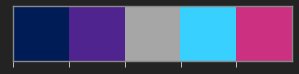

In [2]:
# Set project colors
colors = ['#001c57', '#50248f', '#a6a6a6', '#38d1ff','#cc3181']
sns.palplot(sns.color_palette(colors))

<a id="sec4"></a>
# [FUNCTIONS and CLASSES](#sec4)
[(INDEX)](#sec2)

<a id="sec4"></a>
## [GENERAL FUNCTIONS](#sec4)
[(INDEX)](#sec2)

In [3]:
def missing_vars(data, column, random_proba=True):
    '''Function is called for filling of missing data'''
    # With using probability and random choise

    if random_proba:
        col_name = data[column].value_counts().index.to_list(
        )  # get list of values
        col_distr = data[column].value_counts(
            normalize=True).values  # get l;ist of probs
        missing = data[col].isnull()  # flag of missing val
        # substitute values from the list of names in accordance with the probability of meeting the name
        data.loc[missing, [column]] = np.random.choice(col_name,
                                                    size=len(data[missing]),
                                                    p=col_distr)

    # Using  most common in  column
    data[col] = data[col].fillna(data[col].value_counts().index[0])

In [4]:
def get_variable_distribution(col, title=None):
    '''Function is called to plot feture distribution'''

    title = title if title is not None else f"Distribution for '{col}"
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5),)
    fig = sm.qqplot(col, fit=True, line='45', ax=ax1)
    fig.suptitle(title, fontsize=20)

    sns.distplot(col.values, bins=20, color=colors[1], ax=ax2)
#     sns.violinplot(col.values, color=colors[3], bw=.3, cut=1, linewidth=4)
    sns.boxplot(col.values,color=colors[3])

    ax1.set_title('QQ-plot')
    ax2.set_title('Distribution')
    ax3.set_title('Boxplot')

    plt.show()

In [5]:
def corr_matrix(data, det=True, pltx=10, plty=10):
    '''Funcion is called for making correlation matrix'''

    corr = data.corr()
    if det:

        evals, evec = np.linalg.eig(corr)
        ev_product = np.prod(evals)

        print(f'Rank of Matrix: {np.linalg.matrix_rank(corr)}')
        print(f'Determinant of matrix: {np.round(ev_product,4)}')
        print(f'Shape of matrix: {np.shape(corr)}')

    plt.figure(figsize=(pltx, plty))
    sns.heatmap(corr[(corr >= .2) | (corr <= -.2)],
                cmap='viridis',
                vmin=-1.0,
                linewidths=0.1,
                annot=True,
                annot_kws={"size": 10},
                square=True)
    #     sns.heatmap(X,vmin=0,vmax=.9,annot=True,square=True)
    plt.show()

In [6]:
def cleanTxt(text):
    '''Function is called for cleaning text from trash
    INPUT: dirty string
    OUTPUT: More or less clean string'''

    text = re.sub(r'@[А-Яа-я0-9]+', '', text)  # Remove @
    text = re.sub(r'#', '', text)  # remove #
    text = re.sub(r'{', '', text)
    text = re.sub(r'}', '', text)
    text = re.sub('^а-яА-Я', ' ', text)
    text = re.sub(r'https?:\/\/\S+', '', text)  # remove hyperlink
    text = re.sub(r'\n', '', text)
    text = re.sub(r'👍🏻', '', text)
    # there are much more emoji. I don't know how to identify them so far

    text = text.lower()
    text = text.strip()
    #text = text.split()
    return text

In [7]:
def to_log(df, cols_to_log):
    for col in cols_to_log:
        a = df[col].min()
        if a <= 0:                        
            df[col] = np.log(df[col] + (int(abs(df[col].min()))+2))
        
        df[col] = np.log(df[col])
    return df

In [173]:
# Defining MAPE function since it was removed from sklearn
def mape(y_true, y_pred): 
#     y_true, y_pred = np.expm1(y_true), np.expm1(y_pred)
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true) * 100)

In [9]:
def get_regression_metrics(report_df,y_true, y_pred, name):
    '''Create and add metrics into a pandas DF after experiment'''
    y_true, y_pred = np.expm1(y_true), np.expm1(y_pred)

    report = pd.DataFrame(columns={'MAPE'}, data=[0])
    try:
        report['MAPE'] = mape(y_true, y_pred)
    except:
        report['MAPE'] = 'failed'
    report['MAE'] = mean_absolute_error(y_true, y_pred)
    report['MSE'] = mean_squared_error(y_true, y_pred)
    report['RMSE'] = np.sqrt(mean_squared_error(y_true, y_pred))

    report.index = [name]
    report_df = report_df.append(report)
    return report_df

<a id="sec4"></a>
## [Classes](#sec4)
[(INDEX)](#sec2)

In [10]:
class Encoder():
    def __init__(self, dataframe):
        self.dataframe = dataframe

    def label_encoder(self, column):
        le = LabelEncoder()
        self.dataframe[column] = le.fit_transform(self.dataframe[column])

    def hot_encoder(self, column):
        ohe = OneHotEncoder(handle_unknown='ignore', sparse=False)
        aux_df = pd.DataFrame(ohe.fit_transform(self.dataframe[[column]]))
        aux_df.columns = ohe.get_feature_names([f'hot_{column}'])
        self.dataframe = self.dataframe.drop(col, axis=1)
        self.dataframe = pd.concat([self.dataframe, aux_df], axis=1)
        return self.dataframe

In [11]:
class Outliers_detector():
    def __init__(self, df):
        self.df = df

    def get_IQR_outliers(self, column):
        '''Method is called to detect IQR outliers'''
        outliers = dict()
        q1, q3 = np.percentile(sorted(self.df[column]), [25, 75])

        IQR = q3 - q1

        l_b = q1 - (1.5 * IQR)  # lower bound
        u_b = q3 + (1.5 * IQR)  # upper bound
        outl_count = len(self.df[column][self.df[column] < l_b]) + len(
            self.df[column][self.df[column] > u_b])

        outliers['lower_bound'] = round(l_b, 3)
        outliers['upper_bound'] = round(u_b, 3)
        outliers['outlier_count'] = outl_count

        return outliers

    def get_dbscan_outliers(self, column1, column2, dbscan_eps,
                            dbscan_minsample, cluster_num):
        '''Method is called for detecting outliers for two columns by dbscan'''

        scaler = RobustScaler()
        scale_column1 = scaler.fit_transform(pd.DataFrame(
            self.df[column1])).reshape(1, -1)[0]
        scale_column2 = scaler.fit_transform(pd.DataFrame(
            self.df[column2])).reshape(1, -1)[0]
        df_temp = pd.DataFrame({
            'column1': scale_column1,
            'column2': scale_column2
        })
        clustering = DBSCAN(eps=dbscan_eps,
                            min_samples=dbscan_minsample).fit(df_temp.values)
        df_temp["cluster"] = clustering.labels_
        df_temp.index = self.df.index
        fig = px.scatter(self.df,
                   x=scale_column1,
                   y=scale_column2,
                   color=clustering.labels_,
                   size=column2)
        # Edit the layout
        fig.update_layout(title='Detected Custers\n')
        fig.update_xaxes(title=(f'{column1}'))
        fig.update_yaxes(title=(f'{column2}'))
        fig.update_layout(width = 700)
        fig.update_layout(height = 600)
        
        fig.show()
        #         sns.scatterplot(scale_column1, scale_column2,
        #                         hue=clustering.labels_, alpha=0.5)
        #         plt.title('CLUSTERS\n', fontsize=15)
        #         plt.xlabel(f'{column1}')
        #         plt.ylabel(f'{column2}')
        return df_temp[df_temp["cluster"] == cluster_num].index

<a id="sec4"></a>
## [FUNCTIONS FOR FEATURE ENGINEERING](#sec4)
[(INDEX)](#sec2)

In [12]:
def get_tax_category(engine_power):
    '''Function breaks down the number of horse
    power by taxation category in Russia'''

    if engine_power <= 100:
        return int(1)
    elif 100 < engine_power <= 150:
        return int(2)
    elif 150 < engine_power <= 200:
        return int(3)
    elif 200 < engine_power <= 250:
        return int(4)
    elif engine_power > 250:
        return int(5)


def get_low_registr(word):
    '''Get lowercase for string'''
    try:
        return word.lower()
    except:
        return None
    
def get_i3_displacement(engine_displacement, fuel_type, model_name):
    '''fill mising values for  BMW i3'''
    
    if model_name == 'i3':
        if fuel_type == 'гибрид':
            return 0.7
        else:
            return 0
    else:
        return engine_displacement

def get_electro_displacement(engine_displacement, fuel_type):
    '''Filling mising vars for electrocars'''
    
    if fuel_type == 'электро':
        return 0
    else:
        return engine_displacement
    
def get_acceleration(string):
    '''Function extracting acceleration'''
    
    try:
        return float(re.split(',', re.split('acceleration\W+', str(string))[1])[0])
    except:
        return None
    
def get_fuel_rate(string):
    '''Extrating fuel rate'''
    try:
        return float(re.split(',', re.split('fuel_rate\W+', str(string))[1])[0])

    except:
        return None

<a id="sec5"></a>
# [5.Load and Chek the Dataset](#sec5)
[(INDEX)](#sec2)

In [13]:
# import data pre-processed data set
df = df_combined.copy()
df.sample(2)

,body_type,brand,color,complectation_dict,description,engine_displacement,engine_power,equipment_dict,fuel_type,image,mileage,model_date,model_info,model_name,name,doors_count,price_currency,production_date,sell_id,super_gen,vehicle_configuration,vehicle_transmission,vendor,owner_count,owning_period,car_passport,wheel_drive,wheel_location,condition,custom,price,sample
9690,седан,BMW,синий,"{""id"":""20708465"",""name"":""528i xDrive"",""availab...",Внимание! Только для клиентов AVILON Автомобил...,2.0,245.0,"{""cruise-control"":true,""asr"":true,""esp"":true,""...",бензин,https://autoru.naydex.net/lICN99c69/9bc7d3Rr7k...,100293,2013,"{""code"":""5ER"",""name"":""5 серии"",""ru_name"":""5 се...",5ER,528i xDrive 2.0 AT (245 л.с.) 4WD,4,RUB,2016,1100841476,"{""id"":""10436689"",""name"":""528"",""nameplate"":""528...",SEDAN AUTOMATIC 2.0,AUTOMATIC,EUROPEAN,3,NaN,ORIGINAL,полный,LEFT,Не требует ремонта,Растаможен,NaN,0
167855,внедорожник 5 дв,Hyundai,чёрный,"{'id': '21680831', 'name': 'Rock edition', 'av...",Самая полная и богатая комплектация – лимитиро...,3.5,249.0,"{'sport-seats': True, 'multi-wheel': True, 'au...",бензин,//avatars.mds.yandex.net/get-autoru-vos/190660...,15500,2018,"{'code': 'SANTA_FE', 'name': 'Santa Fe', 'ru_n...",SANTA_FE,3.5 AT (249 л.с.) 4WD,5,RUB,2020,1101585231,"{'id': '21680803', 'displacement': 3470, 'engi...",useless_col,AUTOMATIC,KOREAN,1,"{'year': 2020, 'month': 4}",ORIGINAL,полный,LEFT,True,True,3349000.0,1


<a id="sec6"></a>
# [9.FETAURE ENGINEERING](#sec6)
[(INDEX)](#sec2)

Get lowercase

In [14]:
# take cols with objects
object_columns = df.dtypes[df.dtypes.values == object].index.to_list()

for col in object_columns:
    df[col] = df[col].apply(lambda string: get_low_registr(string))

<a id="sec6"></a>
## [Target](#sec6)
[(INDEX)](#sec2)

Drop rows with car price more than 30 mlns.

In [15]:
idx_to_drop = list(df[df['price'] >= 30000000].index)
df=df.drop(idx_to_drop)

Drop rows with missing values

In [16]:
df.query('sample == 1')['price'].isna().sum()

624

In [17]:
indexes_to_drop = df[(df['price'].isna()) & (df['sample']==1)].index
df = df.drop(indexes_to_drop)

<a id="sec6"></a>
## [body_type](#sec6)
[(INDEX)](#sec2)

Reduce quantity of body_types

In [18]:
pattern = re.compile('[а-я]*')
new_column = []
for string in df['body_type']:
    new_column.append(pattern.match(str(string))[0])
df['body_type'] = new_column

In [19]:
# Create list with top colors
top_colors = df['body_type'].value_counts()[df['body_type'].value_counts(
) > np.percentile((df['body_type'].value_counts().values), 70)].index.tolist()

#take all colors from df to a list
all_colors = df['body_type'].value_counts().index

# Identify, what to delete
colors_to_drop = set(all_colors) - set(top_colors)

# Make replacemewnt
df.loc[df['body_type'].isin(colors_to_drop), 'body_type'] = 'other'

In [20]:
df['body_type'].value_counts()

седан          66648
внедорожник    63983
хэтчбек        16791
other          14990
лифтбек         9291
универсал       7030
Name: body_type, dtype: int64

In [21]:
body_type_dict = dict({
    'седан':'sedan',
    'внедорожник':'4wd',
    'хэтчбек':'hachtback',
    'other':'other',
    'лифтбек':'liftback',
    'универсал':'universal'
})
df['body_type'] = df['body_type'].map(body_type_dict)

In [22]:
df.body_type.unique()

array(['liftback', '4wd', 'hachtback', 'sedan', 'other', 'universal'],
      dtype=object)

<a id="sec6"></a>
## [color](#sec6)
[(INDEX)](#sec2)

With a reference to EDA section we generate new feature to show whether the color is popular.

Meanwhile we re-orgasnize colors in original column by taking only most common colors

In [23]:
# List of top3 colors (see EDA)
popular_color = ['чёрный', 'белый', 'серый']
df['popular_color'] = df['color'].apply(
    lambda color: 1 if color in popular_color else 0)

In [24]:
# Create list with top colors
top_colors = df['color'].value_counts()[df['color'].value_counts(
) > np.percentile((df['color'].value_counts().values), 70)].index.tolist()

#take all colors from df to a list
all_colors = df['color'].value_counts().index

# Identify, what to delete
colors_to_drop = set(all_colors) - set(top_colors)

# Make replacemewnt
df.loc[df['color'].isin(colors_to_drop), 'color'] = 'other'

In [25]:
color_dict = dict({
    'синий':'blue',
    'чёрный':'black',
    'серый':'gray',
    'other':'other',
    'белый':'white',
    'серебристый':'silver'
})
df['color'] = df['color'].map(color_dict)

<a id="sec6"></a>
## [Model_name](#sec6)
[(INDEX)](#sec2)

<a id="sec6"></a>
## [Description](#sec6)
[(INDEX)](#sec2)

Let's generate new features:
- Sensitivity and polarity for the description column

In [26]:
df['description'] = df['description'].fillna('none')
df['description'] = df['description'].apply(cleanTxt)

In [27]:
# Create a function to get the subjectivity
def get_subjectivity(text):
    return TextBlob(text).sentiment.subjectivity

# Create a function to get the polarity
def get_polarity(text):
    return TextBlob(text).sentiment.polarity

In [28]:
# %%script false
# Create new cols and call the func

df['subjectivity'] = df['description'].apply(get_subjectivity)

df['polarity'] = df['description'].apply(get_polarity)


In [29]:
# Create a function to compute the negative, neutral and positive analysis
def get_analysis(score):
    if score < 0:
        return 'negative'
    elif score == 0:
        return 'neutral'
    else:
        return 'positive'

In [30]:
# %%script false
df['analysis'] = df['polarity'].apply(get_analysis)

In [31]:
# show data
df.sample(4)

,body_type,brand,color,complectation_dict,description,engine_displacement,engine_power,equipment_dict,fuel_type,image,mileage,model_date,model_info,model_name,name,doors_count,price_currency,production_date,sell_id,super_gen,vehicle_configuration,vehicle_transmission,vendor,owner_count,owning_period,car_passport,wheel_drive,wheel_location,condition,custom,price,sample,popular_color,subjectivity,polarity,analysis
81102,other,mercedes-benz,black,{'id': '0'},дополнительно: e 250 cdi amg cabrio 9g- tronic...,2.1,204.0,"{'asr': true, 'tinted-glass': true, 'esp': tru...",дизель,//avatars.mds.yandex.net/get-autoru-vos/217183...,74000,2013,"{'code': 'e_klasse', 'name': 'e-класс', 'ru_na...",e_klasse,250 cdi 2.1d at (204 л.с.),2,rub,2015,1091959304,"{'id': '9345304', 'name': '250', 'nameplate': ...",useless_col,automatic,european,1,"{'year': 2019, 'month': 5}",original,задний,left,None,None,2999990.0,1,1,0.0,0.0,neutral
165311,4wd,hyundai,silver,{'id': '0'},.- скидка при покупке в кредит и обмен вашего ...,1.6,123.0,"{'collision-prevention-assist': true, 'steel-w...",бензин,//avatars.mds.yandex.net/get-autoru-vos/440293...,38500,2016,"{'code': 'creta', 'name': 'creta', 'ru_name': ...",creta,1.6 mt (123 л.с.),5,rub,2018,1103566603,"{'id': '20774103', 'displacement': 1591, 'engi...",useless_col,mechanical,korean,1,None,original,передний,left,None,None,1119000.0,1,0,0.0,0.0,neutral
118471,liftback,skoda,silver,{'id': '0'},на автомобиле проведена комплексная диагностик...,1.4,75.0,"{'tinted-glass': true, 'airbag-driver': true, ...",бензин,//avatars.mds.yandex.net/get-autoru-vos/391083...,140000,2000,"{'code': 'octavia', 'name': 'octavia', 'ru_nam...",octavia,1.4 mt (75 л.с.),5,rub,2008,1103125317,"{'id': '2309188', 'displacement': 1390, 'engin...",useless_col,mechanical,european,2,None,original,передний,left,None,None,375000.0,1,0,0.0,0.0,neutral
60815,sedan,nissan,gray,{'id': '0'},собственникесть косяки по кузову в силу своего...,2.0,160.0,"{'condition': true, 'audiosystem-cd': true}",бензин,//avatars.mds.yandex.net/get-autoru-vos/425769...,370000,1998,"{'code': 'cefiro', 'name': 'cefiro', 'ru_name'...",cefiro,2.0 at (160 л.с.),4,rub,1999,1102504126,"{'id': '20471583', 'displacement': 1995, 'engi...",useless_col,automatic,japanese,3,None,duplicate,передний,right,None,None,150000.0,1,1,0.0,0.0,neutral


<a id="sec6"></a>
## [fuel_type](#sec6)
[(INDEX)](#sec2)

In [32]:
# lets strip fuel type
df['fuel_type'] = df.fuel_type.apply(lambda fuel: str(fuel).strip())

In [33]:
fuel_type_dict = dict({
    'бензин':'benzin',
    'дизель':'dizel',
    'гибрид':'hybrid',
    'электро':'electro',
    'газ':'gas'
})

df['fuel_type'] = df['fuel_type'].map(fuel_type_dict)

<a id="sec6"></a>
## [engine_displacement](#sec6)
[(INDEX)](#sec2)

We know, that there is no engine displacement for the electical cars. We also know there is missing values in this colums.

Let's fix it. If car is electric - diplacement shall be 0.

In [34]:
df['engine_displacement'] = df[['engine_displacement','fuel_type']].apply(
    lambda x: get_electro_displacement(*x), axis=1)

It was observed that BMW model i3 has missing values in engine displacement. Let's say if it it is hybrid - then eng_displ - 0.7. If n0 - then 0

In [35]:
df['engine_displacement'] = df[['engine_displacement','fuel_type', 'model_name']].apply(
    lambda x: get_i3_displacement(*x), axis=1)

<a id="sec6"></a>
## [engine_power](#sec6)
[(INDEX)](#sec2)

There is a special low in Russian Federation that devide cars by tax categories. 

More power in engine, higer grade of tax. It may impact on a prediction. Let's break our cars down by such categories

In [36]:
df['tax_rate'] = df['engine_power'].apply(
    lambda engine_power: get_tax_category(engine_power)).astype('category')

<a id="sec6"></a>
## [Super_gen](#sec6)
[(INDEX)](#sec2)

Let's extract some information like an acceleration from supergen column.

Generated new feature Acceleration

In [37]:
# Before we do, fill up empty dictionaries with 'Nan'
df['super_gen'] = df['super_gen'].fillna('NaN')
df['super_gen'] = df['super_gen'].apply(cleanTxt)
# Extract fuel rate,acceleration and generate new feature
df['acceleration'] = df['super_gen'].apply(lambda string:get_acceleration(string))
df['fuel_rate'] = df['super_gen'].apply(lambda string:get_fuel_rate(string))

In [38]:
# missing vars in a new feature
df['acceleration'].isna().sum()

11243

In [39]:
df['fuel_rate'].isna().sum()

21408

Let's fill missing values by randomly choosen value from most common in particular colums.

For a company, add car pasport here and owner count

In [40]:
cols_to_fill = ['acceleration', 'fuel_rate', 'car_passport','owner_count']
for col in cols_to_fill:
    missing_vars(df,col)

<a id="sec6"></a>
## [Wheel drive](#sec6)
[(INDEX)](#sec2)

In [41]:
# lets strip fuel type
df['wheel_drive'] = df.wheel_drive.apply(lambda drive: str(drive).strip())

In [42]:
df['wheel_drive'].unique()

array(['передний', 'полный', 'задний', 'None'], dtype=object)

In [43]:
drive_type_dict = dict({
    'передний':'benzin',
    'полный':'dizel',
    'задний':'hybrid',
    
})

df['wheel_drive'] = df['wheel_drive'].map(drive_type_dict)

<a id="sec6"></a>
## [Price change index ](#sec6)
[(INDEX)](#sec2)

With a reference to EDA, we know, that some brands loose their price more faster than others. Let's generate such feature

In [44]:
def get_change_index(model):
    if model == 'ford':
        return int(1)
    if model == 'volvo' or model == 'mercedes-benz':
        return int(2)
    if model == 'honda' or model == 'audi':
        return int(2)
    return int(0)

In [45]:
df['prc_chg_idx'] = df['brand'].apply(
    lambda brand: get_change_index(brand)).astype('category')

<a id="sec6"></a>
## [Dropping cars without info out](#sec6)
[(INDEX)](#sec2)

In [46]:
df['engine_displacement'].isna().sum()

49

In [47]:
df = df.dropna(axis=0, subset=['engine_displacement'])

<a id="sec6"></a>
## [Handling multicollinearity out](#sec6)
[(INDEX)](#sec2)

In [48]:
# extract trhee columns from dataset, which are correlated
data = df[['mileage', 'model_date','production_date']].values
# create Scaler instance
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

# We have 3 vectors. Reduce to two, taking most important info.
pca = PCA(n_components=2)
pca.fit(scaled_data)
pca_data = pca.transform(scaled_data)
df['pca_1'],df['pca_2'] = pca_data[:,0],pca_data[:,1]
# df = df.drop(['model_date','mileage'],axis=1)

<a id="sec6"></a>
## [Clustering](#sec6)
[(INDEX)](#sec2)

In [49]:
#cluster = Outliers_detector(df)

In [50]:
# indeces = cluster.get_dbscan_outliers('model_date', 'mileage', dbscan_eps=.3,
#                                      dbscan_minsample=12,
#                                      cluster_num=-1)
# print(f"Strange guys {len(indeces)}")

In [57]:
# Defining features and target
X = df[df['sample'] == 1]

X_test = df[df['sample'] == 0]

print(f'X size: {X.shape}, X_testn size: {X_test.shape}')

X size: (144044, 42), X_testn size: (34640, 42)


In [58]:
cluster = Outliers_detector(X)

In [59]:
indeces = cluster.get_dbscan_outliers('model_date', 'price', dbscan_eps=.5,
                                     dbscan_minsample=12,
                                     cluster_num=-1)
print(f"Strange guys {len(indeces)}")

Strange guys 98


In [60]:
X=X.drop(indeces)
X.reset_index(drop=True, inplace=True)

In [62]:
df = X_test.append(X, sort=False).reset_index(drop=True)  # combine sets

<a id="sec6"></a>
## [Logarithm](#sec6)
[(INDEX)](#sec2)

In [64]:
cols_to_log = [
    'engine_displacement',
    'production_date',
    'pca_1', 'pca_2',
    'engine_power',
    'mileage',
    'model_date',
    'acceleration',
    'fuel_rate',
]

df = to_log(df, cols_to_log)

<a id="sec6"></a>
## [ENCODING](#sec6)
[(INDEX)](#sec2)

In [65]:
# Re-set indeces
df.reset_index(drop=True, inplace=True)

In [66]:
# Save un-encoded df
df_cat = df.copy()

In [108]:
encoder = Encoder(df)

In [109]:
to_hot = [
    'body_type',
    'brand',
    'color',
    'fuel_type',    
    'doors_count',
    'vehicle_transmission',
    'vendor',
    'wheel_drive',
    'tax_rate',
    #'analysis',
    'owner_count',
    ]

to_label = ['car_passport', 'wheel_location','prc_chg_idx']

In [110]:
#%%script false
for col in to_hot:
    df = encoder.hot_encoder(col)

In [111]:
for col in to_label:
    encoder.label_encoder(col)

<a id="sec6"></a>
## [DROP COLS OUT](#sec6)
[(INDEX)](#sec2)

In [112]:
cols_to_drop = [
    'complectation_dict',
    'description',
    'equipment_dict',
    'image',
    'model_info',
    'name',
    'price_currency',
    'vehicle_configuration',
    'custom',
    'condition',
    'owning_period',
    'super_gen', 'sell_id',
    'model_name',
    'engine_power',
    'mileage', # have PCA instead
    'model_date', # have PCA instead
    'production_date', # have PCA instead
    'analysis',
]
df = df.drop(cols_to_drop, axis=1)

In [ ]:
corr_matrix(df, det=False)

engine_displacement - 0%
car_passport - 0%
wheel_location - 0%
price - 19%
sample - 0%
popular_color - 0%
subjectivity - 0%
polarity - 0%
acceleration - 0%
fuel_rate - 0%
prc_chg_idx - 0%
pca_1 - 0%
pca_2 - 0%
hot_body_type_4wd - 0%
hot_body_type_hachtback - 0%
hot_body_type_liftback - 0%
hot_body_type_other - 0%
hot_body_type_sedan - 0%
hot_body_type_universal - 0%
hot_brand_audi - 0%
hot_brand_bmw - 0%
hot_brand_ford - 0%
hot_brand_honda - 0%
hot_brand_hyundai - 0%
hot_brand_infiniti - 0%
hot_brand_kia - 0%
hot_brand_lexus - 0%
hot_brand_mazda - 0%
hot_brand_mercedes - 0%
hot_brand_mercedes-benz - 0%
hot_brand_mitsubishi - 0%
hot_brand_nissan - 0%
hot_brand_skoda - 0%
hot_brand_toyota - 0%
hot_brand_volkswagen - 0%
hot_brand_volvo - 0%
hot_color_black - 0%
hot_color_blue - 0%
hot_color_gray - 0%
hot_color_other - 0%
hot_color_silver - 0%
hot_color_white - 0%
hot_fuel_type_benzin - 0%
hot_fuel_type_dizel - 0%
hot_fuel_type_electro - 0%
hot_fuel_type_gas - 0%
hot_fuel_type_hybrid - 0%


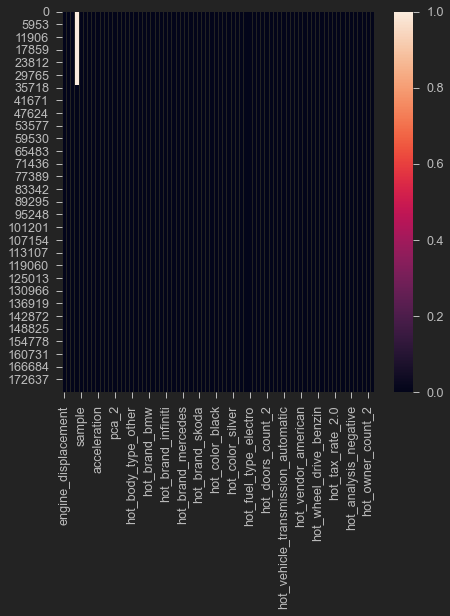

In [72]:
# Plot missing values
cols = df.columns
fig, ax = plt.subplots(figsize=(7, 7))
sns.heatmap(df[cols].isnull()) 

# Show in percents
for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print(f'{col} - {round(pct_missing*100)}%')

<a id="sec6"></a>
## [Scaling](#sec6)
[(INDEX)](#sec2)

In [ ]:
# # Extract the part of dataframe for testing
# df_train = df.query('sample == 1').drop(['sample'], axis=1)
# df_valid = df.query('sample == 0').drop(['sample'], axis=1)

# # Extract data and label
# X = df_train.drop(['price'], axis=1)
# y = df_train[['price']]

# # Extract data for validation
# X_valid = df_valid.drop(['price'], axis=1)

In [ ]:
# cols_to_scal = [
#     'engine_displacement', 'subjectivity', 
#     'polarity', 'acceleration',
#     'fuel_rate', 'pca_1', 'pca_2'
# ]

In [ ]:
# scaler = RobustScaler()
# X[cols_to_scal] = scaler.fit_transform(X[cols_to_scal])
# X_valid[cols_to_scal] = scaler.transform(X_valid[cols_to_scal])

In [ ]:
# print(
#     f'Shape of X_train:{X.shape} \nShape of X_Valid:{X_valid.shape} \nShape of Target:{y.shape} '
# )

<a id="sec6"></a>
# [9.Models](#sec6)
[(INDEX)](#sec2)

In [ ]:
# X_train, X_test, y_train, y_test = train_test_split(
#     X, y, shuffle=True, random_state=42)

In [ ]:
# from lazypredict.Supervised import LazyRegressor

In [ ]:
# %%script false
# reg = LazyRegressor(verbose=1, ignore_warnings=False, custom_metric=None)

In [ ]:
# %%script false
# models,predictions = reg.fit(X_train, X_test, y_train, y_test)

In [ ]:
# %%script false
# models

<a id="sec6"></a>
## [EXTRA-TREE](#sec6)
[(INDEX)](#sec2)

In [ ]:
# def mape(y_true, y_pred): 
#     y_true, y_pred = np.array(y_true), np.array(y_pred)
#     return np.mean(np.abs((y_true - y_pred) / y_true) * 100)

In [117]:
# Defining features and target
X = df[df['sample'] == 1].drop('price', axis=1)
y = np.log(df[df['sample'] == 1]['price'])

X_test = df[df['sample'] == 0].drop(['price'], axis=1)
y_test = df[df['sample'] == 0]['price']

In [115]:
cols_to_scal = [
    'engine_displacement', 'subjectivity', 
    'polarity', 'acceleration',
    'fuel_rate', 'pca_1', 'pca_2'
]

In [118]:
scaler = RobustScaler()
X[cols_to_scal] = scaler.fit_transform(X[cols_to_scal])
X_test[cols_to_scal] = scaler.transform(X_test[cols_to_scal])

In [119]:
# Splitting the data
X_train, X_val, y_train, y_val = train_test_split(X,
                                                  y,
                                                  test_size=0.2,
                                                  shuffle=True,
                                                  random_state=42)

print(
    f'Train size: {X_train.shape}, Validation size: {X_val.shape}, Test size: {X_test.shape}'
)

Train size: (115156, 60), Validation size: (28790, 60), Test size: (34640, 60)


<a id="sec6"></a>
## [EXTRA-TREE](#sec6)
[(INDEX)](#sec2)

In [187]:
# Training and evaluating Random Forest
rf = ExtraTreesRegressor(n_estimators=300, random_state=42, n_jobs=-1,
                         bootstrap=True, verbose=0)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_val)

In [121]:
df_report = pd.DataFrame(data=None)

In [188]:
df_report = get_regression_metrics(df_report,y_val,y_pred, 'ExtraTree_baseline')
df_report

,MAPE,MAE,MSE,RMSE
ExtraTree_baseline,16.806633,131955.599146,8.775773e+10,2.962393e+05
XGBoost_1,16.551940,132564.307963,8.677676e+10,2.945790e+05
LGB+optuna,28.925294,395253.398853,1.021182e+12,1.010535e+06
LGB+optuna,28.925294,395253.398853,1.021182e+12,1.010535e+06
Neural,326.704735,208468.212288,2.232277e+11,4.724698e+05
Neural,326.704735,208468.212288,2.232277e+11,4.724698e+05
ExtraTree_baseline,16.806633,131955.599146,8.775773e+10,2.962393e+05


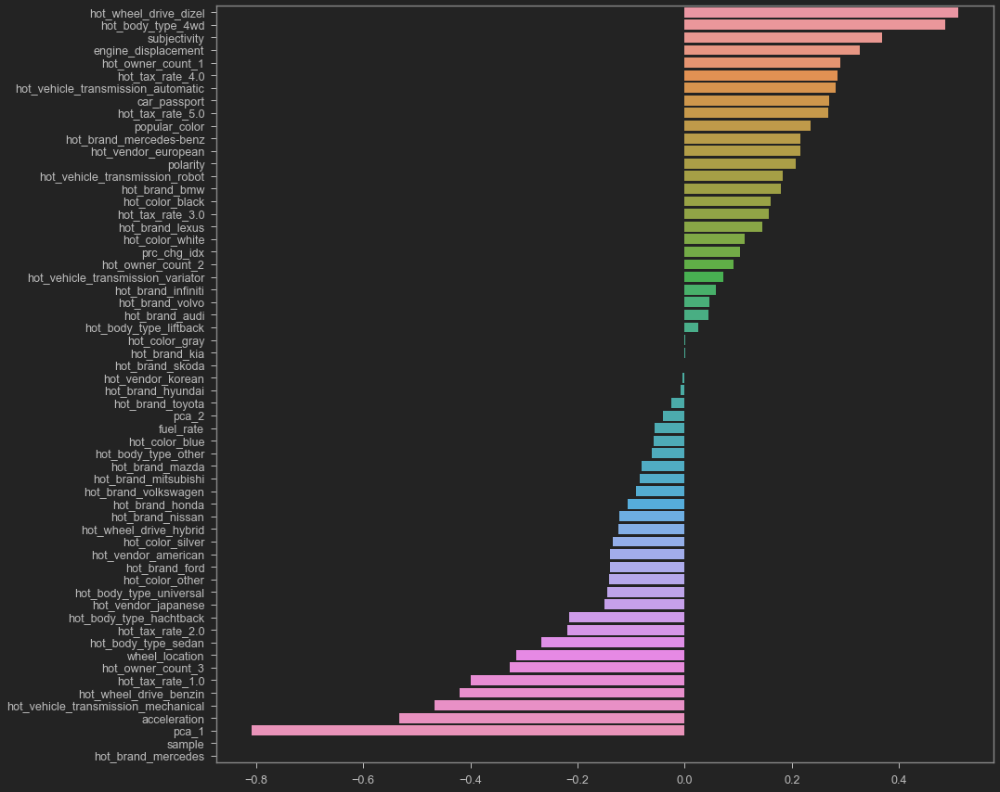

In [123]:
correlations = X_train.corrwith(y_train).sort_values(ascending=False)
plt.figure(figsize=(15, 15))
sns.barplot(y=correlations.index, x=correlations)
plt.show()

<a id="sec6"></a>
## [CAT_boost](#sec6)
[(INDEX)](#sec2)

In [ ]:
# # Training the model
# cbr = CatBoostRegressor()

# # Grid search for catboost model
# param_grid = {'iterations': [500],
#               'learning_rate': [0.01, 0.1, 0.25, 0.5],
#               'l2_leaf_reg': [1, 3, 5, 10],
#               'depth': np.arange(10, 14),
#               'thread_count': [4]}

# cbr.grid_search(param_grid=param_grid,
#                 X=X,
#                 y=y,
#                 cv=5,
#                 partition_random_seed=42,
#                 calc_cv_statistics=True,
#                 search_by_train_test_split=True,
#                 refit=True,
#                 shuffle=True,
#                 stratified=None,
#                 train_size=0.8,
#                 verbose=False,
#                 plot=True)

In [ ]:
# grid_search = GridSearchCV(cbr, param_grid, n_jobs=-1,
#                            scoring=mape, cv=5, refit=True,
#                            return_train_score=True, verbose=5)

# grid_search.fit(X, y)

In [ ]:
# Best model parameters
# cbr.get_params()

In [ ]:
# mape(np.exp(y_val), np.exp(cbr.predict(X_val)))

# XGBoost

In [124]:
# Training xgboost model
xg_reg = xgb.XGBRegressor(objective='reg:squarederror', colsample_bytree=0.5,
                          learning_rate=0.05, max_depth=12, alpha=1,
                          n_estimators=1000, silent=1)
xg_reg.fit(X_train, y_train)
xg_red_pred = xg_reg.predict(X_val)

[20:59:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




In [125]:
df_report = get_regression_metrics(df_report,y_val,xg_red_pred, 'XGBoost_1')
df_report

,MAPE,MAE,MSE,RMSE
ExtraTree_baseline,16.806633,131955.599146,8.775773e+10,296239.313974
XGBoost_1,16.551940,132564.307963,8.677676e+10,294578.961051


<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

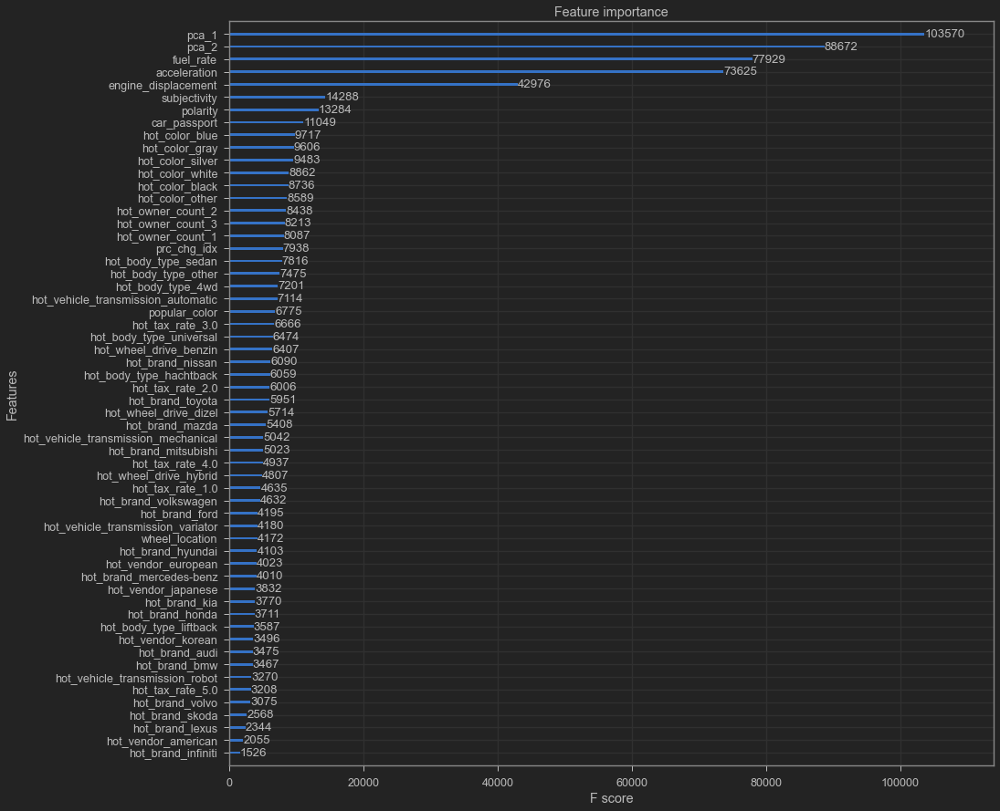

In [126]:
fig, ax = plt.subplots(1,1,figsize=(15,15))
plot_importance(xg_reg,ax=ax)

In [ ]:
# ddd = ['hot_fuel_type_gas','hot_fuel_type_electro','hot_analysis_negative',
#       'hot_fuel_type_hybrid','hot_brand_infiniti','hot_analysis_positive',
#       'hot_vendor_american','hot_brand_lexus','hot_analysis_neutral',
#       'hot_brand_skoda','hot_vehicle_transmission_robot','hot_tax_rate_5.0',
#       'hot_brand_volvo','hot_doors_count_2','hot_body_type_liftback',
#       'hot_brand_audi','hot_brand_honda','wheel_location','hot_vendor_korean',
#       'hot_brand_bmw','hot_brand_kia','hot_vendor_japanese',]

In [ ]:
# X_train.columns

In [ ]:
# X_train_red = X_train.drop(ddd, axis=1)
# X_val_red = X_val.drop(ddd, axis=1)

In [ ]:
# # Training xgboost model
# xg_reg = xgb.XGBRegressor(objective='reg:squarederror', colsample_bytree=0.5,
#                           learning_rate=0.05, max_depth=12, alpha=1,
#                           n_estimators=1000, silent=1)
# xg_reg.fit(X_train_red, y_train)
# xg_red_pred = xg_reg.predict(X_val_red)

In [ ]:
# df_report = get_regression_metrics(df_report,y_val,xg_red_pred, 'XGBoost_reduced_features')
# df_report

In [ ]:
# fig, ax = plt.subplots(1,1,figsize=(15,15))
# plot_importance(xg_reg,ax=ax)

## OPTUNA

In [127]:
def objective(trial, data=X, target=y):

    train_x, test_x, train_y, test_y = train_test_split(
        data, target, test_size=0.15, random_state=42)
    param = {
        # this parameter means using the GPU when training our model to speedup the training process
        'tree_method': "gpu_hist",#'exact',
        'lambda': trial.suggest_loguniform('lambda', 1e-3, 10.0),
        'alpha': trial.suggest_loguniform('alpha', 1e-3, 10.0),
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.4, 0.5, 0.6, 0.7, 0.8, 1.0]),
        'learning_rate': trial.suggest_categorical('learning_rate', [0.008, 0.009, 0.01, 0.012, 0.014, 0.016, 0.018, 0.02]),
        'n_estimators': trial.suggest_categorical('n_estimators', [100,200,400,800]),
        'max_depth': trial.suggest_categorical('max_depth', [5, 7, 9, 11, 13, 15, 17, 20]),
        'random_state': trial.suggest_categorical('random_state', [24, 48, 2020]),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 300),
    }
    model = xgb.XGBRegressor(**param)

    model.fit(train_x, train_y, eval_set=[
              (test_x, test_y)], early_stopping_rounds=100, verbose=False)

    preds = model.predict(test_x)

    rmse = mean_squared_error(test_y, preds, squared=False)

    return rmse

In [128]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-05-27 21:02:20,917] A new study created in memory with name: no-name-b1eccaa7-d357-429a-af81-ffad5095c01d
[I 2021-05-27 21:02:22,797] Trial 0 finished with value: 1.7887489904099476 and parameters: {'lambda': 0.022948328641464295, 'alpha': 0.7023730105081069, 'colsample_bytree': 0.3, 'subsample': 0.4, 'learning_rate': 0.02, 'n_estimators': 100, 'max_depth': 9, 'random_state': 48, 'min_child_weight': 55}. Best is trial 0 with value: 1.7887489904099476.
[I 2021-05-27 21:02:24,270] Trial 1 finished with value: 2.19320622095575 and parameters: {'lambda': 2.3325809682781125, 'alpha': 0.314689554376681, 'colsample_bytree': 0.5, 'subsample': 0.5, 'learning_rate': 0.009, 'n_estimators': 200, 'max_depth': 5, 'random_state': 24, 'min_child_weight': 71}. Best is trial 0 with value: 1.7887489904099476.
[I 2021-05-27 21:02:41,135] Trial 2 finished with value: 0.27405757353204413 and parameters: {'lambda': 0.0735701205101106, 'alpha': 6.3253431487265415, 'colsample_bytree': 0.5, 'subsample':

[I 2021-05-27 21:13:27,502] Trial 23 finished with value: 0.24883564801490188 and parameters: {'lambda': 0.745880420394593, 'alpha': 0.0343333707007687, 'colsample_bytree': 0.8, 'subsample': 0.6, 'learning_rate': 0.018, 'n_estimators': 1500, 'max_depth': 17, 'random_state': 2020, 'min_child_weight': 9}. Best is trial 23 with value: 0.24883564801490188.
[I 2021-05-27 21:15:35,844] Trial 24 finished with value: 0.24993467550367068 and parameters: {'lambda': 0.20714065400614978, 'alpha': 0.06912668115383439, 'colsample_bytree': 0.8, 'subsample': 0.8, 'learning_rate': 0.018, 'n_estimators': 1500, 'max_depth': 17, 'random_state': 2020, 'min_child_weight': 5}. Best is trial 23 with value: 0.24883564801490188.
[I 2021-05-27 21:18:40,156] Trial 25 finished with value: 0.2553854662363855 and parameters: {'lambda': 0.15983782870815466, 'alpha': 0.014807368103699734, 'colsample_bytree': 0.4, 'subsample': 0.8, 'learning_rate': 0.018, 'n_estimators': 1500, 'max_depth': 17, 'random_state': 2020, 'mi

[I 2021-05-27 21:35:43,061] Trial 46 finished with value: 0.25582771970913065 and parameters: {'lambda': 0.013938311407547732, 'alpha': 0.04194779831319774, 'colsample_bytree': 0.8, 'subsample': 0.8, 'learning_rate': 0.008, 'n_estimators': 800, 'max_depth': 9, 'random_state': 2020, 'min_child_weight': 1}. Best is trial 23 with value: 0.24883564801490188.
[I 2021-05-27 21:35:59,937] Trial 47 finished with value: 0.2625785308851253 and parameters: {'lambda': 0.08381825011875263, 'alpha': 0.28920940343022916, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.01, 'n_estimators': 1500, 'max_depth': 7, 'random_state': 2020, 'min_child_weight': 110}. Best is trial 23 with value: 0.24883564801490188.
[I 2021-05-27 21:36:04,552] Trial 48 finished with value: 0.36492025787713306 and parameters: {'lambda': 0.9031620638989356, 'alpha': 0.13857061912653224, 'colsample_bytree': 0.8, 'subsample': 0.4, 'learning_rate': 0.02, 'n_estimators': 200, 'max_depth': 13, 'random_state': 2020, 'min_

Number of finished trials: 50
Best trial: {'lambda': 0.745880420394593, 'alpha': 0.0343333707007687, 'colsample_bytree': 0.8, 'subsample': 0.6, 'learning_rate': 0.018, 'n_estimators': 1500, 'max_depth': 17, 'random_state': 2020, 'min_child_weight': 9}


In [129]:
param_xb = study.best_params

In [130]:
reg_xb = xgb.XGBClassifier(param = param_xb)

reg_xb.fit(X_train, y_train)
reg_xb_pred = reg_xb.predict(X_val)

[21:38:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "param" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:41:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


KeyboardInterrupt: 

In [ ]:
df_report = get_regression_metrics(df_report,y_val,reg_xb_pred, 'XGBoost_opt')
df_report

# LGBM

In [ ]:
# Defining lightgbm hyper-parameters
hyper_params = {
                'task': 'train',
                'boosting_type': 'gbdt',
                'objective': 'regression',
                'metric': ['mape'],
                'learning_rate': 0.05,
                'feature_fraction': 0.9,
                'bagging_fraction': 0.7,
                'bagging_freq': 10,
                'verbose': 0,
                "max_depth": 12,
                "num_leaves": 128,  
                "max_bin": 512,
                "num_iterations": 1000,
                "n_estimators": 1000
            }

# Training lightgbm model
lgbm = lgb.LGBMRegressor(**hyper_params)
lgbm.fit(X_train, y_train,
         eval_set=[(X_val, y_val)],
         eval_metric='l1',
         early_stopping_rounds=100)

# Printing the result
# mape(np.exp(y_val), np.exp(lgbm.predict(X_val)))


In [ ]:
lgb_pred = lgbm.predict(X_val)

In [ ]:
df_report = get_regression_metrics(df_report,y_val,lgb_pred, 'LGB')
df_report

In [ ]:
# Check permutation
lightgbm.plot_importance(lgbm, ax=None, height=0.2, xlim=None, ylim=None,
                         title='Feature importance', xlabel='Feature importance', 
                         ylabel='Features', importance_type='split', max_num_features=None,
                         ignore_zero=True, figsize=(10,10), dpi=None, grid=True, precision=3);

# LGBM Optuna

In [138]:
# Defining MAPE function since it was removed from sklearn
def mape_11(y_pred,y_true): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true) * 100)

In [143]:
def objective(trial,data=X,target=y):
    
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.2,random_state=42)
    param = {
        'metric': 'mape', 
        'random_state': 42,
        'n_estimators': 500,
        #'n_estimators': trial.suggest_categorical('n_estimators', [50, 100,500,1000]),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02]),
        'max_depth': trial.suggest_categorical('max_depth', [10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 1, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'cat_smooth' : trial.suggest_int('min_data_per_groups', 1, 100)
    }
    model = lgb.LGBMRegressor(**param)  
    
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)],early_stopping_rounds=100,verbose=False)
    
    preds = model.predict(test_x)
    
    mape = mape_11(np.expm1(test_y), np.expm1(preds))
    
    return mape

In [144]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)

[I 2021-05-27 22:52:15,314] A new study created in memory with name: no-name-b15d7ea3-9d6b-4225-b2ca-ed5aac5ffee4
[I 2021-05-27 22:52:23,107] Trial 0 finished with value: 16.21633957999909 and parameters: {'reg_alpha': 5.84281065039989, 'reg_lambda': 0.012268776759102566, 'colsample_bytree': 0.9, 'subsample': 0.4, 'learning_rate': 0.017, 'max_depth': 100, 'num_leaves': 901, 'min_child_samples': 49, 'min_data_per_groups': 69}. Best is trial 0 with value: 16.21633957999909.
[I 2021-05-27 22:52:30,004] Trial 1 finished with value: 15.978914649823636 and parameters: {'reg_alpha': 0.004928282556415217, 'reg_lambda': 0.04667790583015405, 'colsample_bytree': 0.8, 'subsample': 0.4, 'learning_rate': 0.02, 'max_depth': 20, 'num_leaves': 552, 'min_child_samples': 138, 'min_data_per_groups': 16}. Best is trial 1 with value: 15.978914649823636.
[I 2021-05-27 22:52:32,701] Trial 2 finished with value: 20.6640554868247 and parameters: {'reg_alpha': 0.017592867040429068, 'reg_lambda': 0.00866119751050

[I 2021-05-27 22:54:45,683] Trial 22 finished with value: 15.857398856817849 and parameters: {'reg_alpha': 0.008497603017135869, 'reg_lambda': 2.941813622803263, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.02, 'max_depth': 20, 'num_leaves': 996, 'min_child_samples': 92, 'min_data_per_groups': 29}. Best is trial 19 with value: 15.856272474652734.
[I 2021-05-27 22:54:54,524] Trial 23 finished with value: 15.881330111829511 and parameters: {'reg_alpha': 0.06044768978721258, 'reg_lambda': 3.472197127264896, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.02, 'max_depth': 20, 'num_leaves': 950, 'min_child_samples': 93, 'min_data_per_groups': 28}. Best is trial 19 with value: 15.856272474652734.
[I 2021-05-27 22:55:03,477] Trial 24 finished with value: 15.837249517675545 and parameters: {'reg_alpha': 0.05962014854422387, 'reg_lambda': 3.781209532792227, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.02, 'max_depth': 20, 'num_leaves': 894, 'min_c

[I 2021-05-27 22:58:20,269] Trial 44 finished with value: 16.044822356575853 and parameters: {'reg_alpha': 0.03500105366644607, 'reg_lambda': 5.532888912549761, 'colsample_bytree': 0.6, 'subsample': 0.8, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 631, 'min_child_samples': 54, 'min_data_per_groups': 61}. Best is trial 30 with value: 15.733243642744927.
[I 2021-05-27 22:58:30,262] Trial 45 finished with value: 15.742868410595037 and parameters: {'reg_alpha': 0.2087505158377315, 'reg_lambda': 6.4983621798826965, 'colsample_bytree': 0.9, 'subsample': 0.6, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 713, 'min_child_samples': 34, 'min_data_per_groups': 72}. Best is trial 30 with value: 15.733243642744927.
[I 2021-05-27 22:58:31,121] Trial 46 finished with value: 30.820846975236115 and parameters: {'reg_alpha': 0.10155060820878882, 'reg_lambda': 9.9382291534961, 'colsample_bytree': 0.5, 'subsample': 1.0, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 2, 'min_chi

In [145]:
# plot_optimization_histor: shows the scores from all trials as 
# well as the best score so far at each point.
optuna.visualization.plot_optimization_history(study)

In [146]:
#plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
optuna.visualization.plot_parallel_coordinate(study)

In [147]:
'''plot_slice: shows the evolution of the search. You can see where in the hyperparameter space your search
went and which parts of the space were explored more.'''
optuna.visualization.plot_slice(study)

In [148]:
#Visualize parameter importances.
optuna.visualization.plot_param_importances(study)

In [150]:
#Visualize empirical distribution function
optuna.visualization.plot_edf(study)

In [149]:
param_lgb = study.best_params

In [157]:
lgb_opt = lgb.LGBMRegressor(**param_lgb)
lgb_opt.fit(X_train, y_train,)
#          eval_set=[(X_val, y_val)],
#          eval_metric='l1',
#          early_stopping_rounds=100)


LGBMRegressor(colsample_bytree=0.9, learning_rate=0.017, max_depth=20,
              min_child_samples=56, min_data_per_groups=43, num_leaves=862,
              reg_alpha=0.12558700456111194, reg_lambda=8.537201814924735,
              subsample=0.7)

In [158]:
lgb_opt_pred = lgb_opt.predict(X_val)

In [159]:
df_report = get_regression_metrics(df_report,y_val,lgb_opt_pred, 'LGB+optuna')
df_report

,MAPE,MAE,MSE,RMSE
ExtraTree_baseline,16.806633,131955.599146,8.775773e+10,2.962393e+05
XGBoost_1,16.551940,132564.307963,8.677676e+10,2.945790e+05
LGB+optuna,28.925294,395253.398853,1.021182e+12,1.010535e+06
LGB+optuna,28.925294,395253.398853,1.021182e+12,1.010535e+06


## Gradient boost

In [ ]:
params = {'n_estimators': 500,
          'max_depth': 4,
          'min_samples_split': 5,
          'learning_rate': 0.01,
          'loss': 'ls'}

In [ ]:
gboost = GradientBoostingRegressor(**params)
gboost.fit(X_train, y_train)
gboost_pred = gboost.predict(X_val)

In [ ]:
df_report = get_regression_metrics(df_report,y_val,gboost_pred, 'GBOOST')
df_report

In [ ]:
test_score = np.zeros((params['n_estimators'],), dtype=np.float64)
for i, y_pred in enumerate(gboost.staged_predict(X_test)):
    test_score[i] = gboost.loss_(y_val, gboost_pred)

fig = plt.figure(figsize=(6, 6))
plt.subplot(1, 1, 1)
plt.title('Deviance')
plt.plot(np.arange(params['n_estimators']) + 1, gboost.train_score_, 'b-',
         label='Training Set Deviance')
plt.plot(np.arange(params['n_estimators']) + 1, test_score, 'r-',
         label='Test Set Deviance')
plt.legend(loc='upper right')
plt.xlabel('Boosting Iterations')
plt.ylabel('Deviance')
fig.tight_layout()
plt.show()

# Гвоздь программы

In [161]:
from keras.models import Sequential
from keras.layers import Dense

In [164]:
model = Sequential()
model.add(Dense(128, activation='relu', input_shape=(X_train.shape[1])))
model.add(Dense(1))

In [189]:
model.compile(optimizer = 'adam', loss='mse', metrics=['mape'])

In [190]:
model.fit(X_train, y_train, epochs= 100, batch_size = 1,verbose=1)

Epoch 1/100
115156/115156 [==============================] - 43s 369us/step - loss: 0.0736 - mape: 1.3749
Epoch 2/100
115156/115156 [==============================] - 43s 369us/step - loss: 0.0744 - mape: 1.3855
Epoch 3/100
115156/115156 [==============================] - 43s 369us/step - loss: 0.0752 - mape: 1.3819
Epoch 4/100
115156/115156 [==============================] - 43s 369us/step - loss: 0.0746 - mape: 1.3842
Epoch 5/100
115156/115156 [==============================] - 43s 371us/step - loss: 0.0742 - mape: 1.3865
Epoch 6/100
115156/115156 [==============================] - 43s 378us/step - loss: 0.0753 - mape: 1.3862
Epoch 7/100
115156/115156 [==============================] - 43s 369us/step - loss: 0.0737 - mape: 1.3764
Epoch 8/100
115156/115156 [==============================] - 43s 370us/step - loss: 0.0736 - mape: 1.3739
Epoch 9/100
115156/115156 [==============================] - 42s 369us/step - loss: 0.0730 - mape: 1.3711
Epoch 10/100
115156/115156 [==================

KeyboardInterrupt: 

In [171]:
pred = model.predict(X_val)

In [186]:
df_report = get_regression_metrics(df_report,y_val,pred, 'Neural')
df_report

,MAPE,MAE,MSE,RMSE
ExtraTree_baseline,16.806633,131955.599146,8.775773e+10,2.962393e+05
XGBoost_1,16.551940,132564.307963,8.677676e+10,2.945790e+05
LGB+optuna,28.925294,395253.398853,1.021182e+12,1.010535e+06
LGB+optuna,28.925294,395253.398853,1.021182e+12,1.010535e+06
Neural,326.704735,208468.212288,2.232277e+11,4.724698e+05
Neural,326.704735,208468.212288,2.232277e+11,4.724698e+05


## STACKING

In [ ]:
from mlxtend.regressor import StackingRegressor

In [ ]:
ENet = ElasticNet()

In [ ]:
stck_regrs = StackingRegressor(regressors=[rf, xg_reg, lgbm],
                               meta_regressor=ENet)

In [ ]:
stck_regrs.fit(X_train,y_train)

In [ ]:
y_pred_stck_regrs = stck_regrs.predict(X_val)

In [ ]:
df_report = get_regression_metrics(df_report,y_val,y_pred_stck_regrs, 'Stack')
df_report

In [ ]:
#ensemble = y_pred_stck_regrs*0.70 + xgb_pred*0.1 + lgb_pred*0.1